# Membros

Ana Luisa Conrado Ferreira de Oliveira - 801583

Lucas Abbiati Pereira - 801572

Caio Obatake Watari Gonçalves Cadini - 800383

Vitor Enzo Araujo Costa - 802123

Vinícius Matheus Romualdo Santos - 801258

## Instalando dependências

In [239]:
!pip install plotly
!pip install nbformat
!pip install hdbscan
!pip install yellowbrick
!pip install spotipy
!pip install skimage

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


## Dicionário dos dados

[Spotify API](https://developer.spotify.com/documentation/web-api/reference/#/operations/get-several-audio-features)

* `Acousticness/Acústica:` Variável numérica, medida de confiança de 0,0 a 1,0 se a faixa é acústica. 1.0 representa alta confiança de que a faixa é acústica.

* `Danceability/Dançabilidade:` Variável numérica, a dançabilidade descreve o quão adequada uma faixa é para dançar com base em uma combinação de elementos musicais, incluindo tempo, estabilidade do ritmo, força da batida e regularidade geral. Um valor de 0,0 é o menos dançável e 1,0 é o mais dançável.

* `Duration_ms:`Variável numérica, a duração da trilha em milissegundos.

* `Duration_min:` Variável numérica, a duração da faixa em minutos.

* `Energy/Energia:` Variável numérica, Energia é uma medida de 0,0 a 1,0 e representa uma medida perceptiva de intensidade e atividade. Normalmente, as faixas energéticas parecem rápidas, altas e barulhentas. Por exemplo, o death metal tem alta energia, enquanto um prelúdio de Bach tem uma pontuação baixa na escala. As características perceptivas que contribuem para este atributo incluem faixa dinâmica, intensidade percebida, timbre, taxa de início e entropia geral.

* `Explicit/Explícito:` Variável categórica, se a faixa tem ou não letras explícitas (verdadeiro = sim (1); falso = não(0), não OU desconhecido).

* `Id:` O ID do Spotify para a faixa.

* `Instrumentalness/Instrumentalidade:` Variável numérica, prevê se uma faixa não contém vocais. Os sons “Ooh” e “aah” são tratados como instrumentais neste contexto. Faixas de rap ou de palavras faladas são claramente “vocais”. Quanto mais próximo o valor de instrumentalidade estiver de 1,0, maior a probabilidade de a faixa não conter conteúdo vocal. Valores acima de 0,5 destinam-se a representar faixas instrumentais, mas a confiança é maior à medida que o valor se aproxima de 1,0.

* `Key/Chave:`Variável numérica, a chave geral estimada da faixa. Os inteiros são mapeados para pitchs usando a notação padrão de Pitch Class. Por exemplo. 0 = C, 1 = C#/Db, 2 = D, e assim por diante. Se nenhuma chave foi detectada, o valor é -1.

* `Liveness/ Ao vivo:` Variável numérica, detecta a presença de um público na gravação. Valores mais altos de vivacidade representam uma probabilidade maior de que a faixa tenha sido executada ao vivo. Um valor acima de 0,8 fornece uma forte probabilidade de que a faixa esteja ativa.

* `Loudness/ Volume em dB:` Variável numérica, volume geral de uma faixa em decibéis (dB). Os valores de volume são calculados em média em toda a faixa e são úteis para comparar o volume relativo das faixas. A sonoridade é a qualidade de um som que é o principal correlato psicológico da força física (amplitude). Os valores típicos variam entre -60 e 0 db.

* `Mode/ Modo:` Variável numérica, o modo indica a modalidade (maior ou menor) de uma faixa, o tipo de escala da qual seu conteúdo melódico é derivado. Maior é representado por 1 e menor é 0.

* `Popularity/Popularidade:` Variável numérica, a popularidade de uma faixa é um valor entre 0 e 100, sendo 100 o mais popular. A popularidade é calculada por algoritmo e é baseada, em grande parte, no número total de execuções que a faixa teve e quão recentes são essas execuções.

* `Speechiness/Fala:` Variável numérica, a fala detecta a presença de palavras faladas em uma faixa. Quanto mais exclusivamente falada a gravação (por exemplo, talk show, audiolivro, poesia), mais próximo de 1,0 o valor do atributo. Valores acima de 0,66 descrevem faixas que provavelmente são feitas inteiramente de palavras faladas. Valores entre 0,33 e 0,66 descrevem faixas que podem conter música e fala, seja em seções ou em camadas, incluindo casos como música rap. Os valores abaixo de 0,33 provavelmente representam músicas e outras faixas que não são de fala.

* `Tempo:` Variável numérica, Tempo estimado geral de uma faixa em batidas por minuto (BPM). Na terminologia musical, tempo é a velocidade ou ritmo de uma determinada peça e deriva diretamente da duração média da batida.

* `Valence/Valência:` Variável numérica, Medida de 0,0 a 1,0 descrevendo a positividade musical transmitida por uma faixa. Faixas com alta valência soam mais positivas (por exemplo, feliz, alegre, eufórica), enquanto faixas com baixa valência soam mais negativas (por exemplo, triste, deprimida, irritada).

* `Year/Ano:` Ano em que a música foi lançada.

## Análise dos dados

**Bases usadas**

* [Dados gerais de músicas](https://raw.githubusercontent.com/sthemonica/music-clustering/main/Dados/Dados_totais.csv)

* [Dados relacionados à gêneros](https://raw.githubusercontent.com/sthemonica/music-clustering/main/Dados/data_by_genres.csv)

* [Dados relacionados aos anos](https://raw.githubusercontent.com/sthemonica/music-clustering/main/Dados/data_by_year.csv)

In [240]:
import numpy as np
import pandas as pd

In [241]:
dados = pd.read_csv('https://raw.githubusercontent.com/sthemonica/music-clustering/main/Dados/Dados_totais.csv')
dados_generos = pd.read_csv('https://raw.githubusercontent.com/sthemonica/music-clustering/main/Dados/data_by_genres.csv')
dados_anos = pd.read_csv('https://raw.githubusercontent.com/sthemonica/music-clustering/main/Dados/data_by_year.csv')

In [242]:
dados.to_csv('dados_gerais.csv')
dados_generos.to_csv("dados_gerais_generos.csv")
dados_anos.to_csv("dados_gerais_anos.csv")

In [243]:
dados.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,20311.000000,20311.000000,20311.000000,20311.000000,2.031100e+04,20311.000000,20311.000000,20311.000000,20311.000000,20311.000000,20311.000000,20311.000000,20311.000000,20311.000000,20311.000000
mean,0.481928,2010.183201,0.242799,0.587702,2.286290e+05,0.650766,0.279504,0.060173,5.239673,0.194004,-7.083095,0.659052,56.441879,0.100602,122.074260
std,0.246413,6.063968,0.284416,0.171322,7.046523e+04,0.221774,0.448766,0.199315,3.583479,0.157758,4.320102,0.474040,11.560951,0.106060,30.865188
min,0.000000,2000.000000,0.000000,0.000000,3.030100e+04,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.288000,2005.000000,0.016700,0.477000,1.920000e+05,0.516000,0.000000,0.000000,2.000000,0.097600,-8.110000,0.000000,48.000000,0.035700,96.117500
50%,0.472000,2010.000000,0.114000,0.596000,2.216270e+05,0.680000,0.000000,0.000002,5.000000,0.128000,-6.072000,1.000000,56.000000,0.052400,120.109000
75%,0.672000,2015.000000,0.395000,0.714000,2.561330e+05,0.826000,1.000000,0.000512,8.000000,0.248000,-4.629500,1.000000,64.000000,0.116000,143.667500
max,1.000000,2020.000000,0.996000,0.986000,2.558287e+06,0.999000,1.000000,1.000000,11.000000,0.997000,1.483000,1.000000,100.000000,0.950000,220.099000


In [244]:
dados.head(2)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,speechiness,tempo,artists_song
0,0.285,2000,0.00239,Coldplay,0.429,266773,0.661,0,3AJwUDP919kvQ9QcozQPxg,0.000121,11,0.2340,-7.227,1,Yellow,84,0.0281,173.372,Coldplay - Yellow
1,0.613,2000,0.14300,OutKast,0.843,270507,0.806,1,0I3q5fE6wg7LIfHGngUTnV,0.000000,4,0.0771,-5.946,0,Ms. Jackson,80,0.2690,94.948,OutKast - Ms. Jackson


In [245]:
dados["year"].unique()

array([2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010,
       2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020])

In [246]:
dados.shape

(20311, 19)

In [247]:
dados = dados.drop(["explicit", "key", "mode"], axis=1)
dados.head(2)

,valence,year,acousticness,artists,danceability,duration_ms,energy,id,instrumentalness,liveness,loudness,name,popularity,speechiness,tempo,artists_song
0,0.285,2000,0.00239,Coldplay,0.429,266773,0.661,3AJwUDP919kvQ9QcozQPxg,0.000121,0.2340,-7.227,Yellow,84,0.0281,173.372,Coldplay - Yellow
1,0.613,2000,0.14300,OutKast,0.843,270507,0.806,0I3q5fE6wg7LIfHGngUTnV,0.000000,0.0771,-5.946,Ms. Jackson,80,0.2690,94.948,OutKast - Ms. Jackson


In [248]:
dados.shape

(20311, 16)

In [249]:
dados.isna().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
id                  0
instrumentalness    0
liveness            0
loudness            0
name                0
popularity          0
speechiness         0
tempo               0
artists_song        0
dtype: int64

In [250]:
dados_generos.head(2)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.3616,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.1310,-16.854000,0.076817,120.285667,0.221750,52.500000,5


In [251]:
dados_generos = dados_generos.drop(["key", "mode"], axis=1)
dados_generos.head(2)

,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity
0,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.3616,-31.514333,0.040567,75.336500,0.103783,27.833333
1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.1310,-16.854000,0.076817,120.285667,0.221750,52.500000


In [252]:
dados_generos.isnull().sum()

genres              0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
dtype: int64

In [253]:
dados_anos.head(2)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.20571,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.24072,-19.275282,0.116655,100.884521,0.535549,0.140845,10


In [254]:
dados_anos["year"].unique()

array([1921, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931,
       1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942,
       1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953,
       1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964,
       1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975,
       1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986,
       1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997,
       1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008,
       2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019,
       2020])

In [255]:
dados_anos = dados_anos[dados_anos["year"]>=2000]
dados_anos["year"].unique()

array([2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010,
       2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020])

In [256]:
dados_anos = dados_anos.drop(["key", "mode"], axis=1)
dados_anos.head(2)

,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity
79,2000,0.289323,0.590918,242724.642638,0.625413,0.101168,0.197686,-8.247766,0.089205,118.999323,0.559475,46.684049
80,2001,0.286842,0.583318,240307.796010,0.626986,0.107214,0.187026,-8.305095,0.089182,117.765399,0.541479,48.750125


In [257]:
dados_anos.reset_index()

,index,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity
0,79,2000,0.289323,0.590918,242724.642638,0.625413,0.101168,0.197686,-8.247766,0.089205,118.999323,0.559475,46.684049
1,80,2001,0.286842,0.583318,240307.796010,0.626986,0.107214,0.187026,-8.305095,0.089182,117.765399,0.541479,48.750125
2,81,2002,0.282624,0.576160,239503.283000,0.641270,0.088048,0.193911,-7.686640,0.084308,119.239738,0.542397,48.655500
3,82,2003,0.256471,0.575763,244670.575230,0.660165,0.083049,0.196976,-7.485545,0.093926,120.914622,0.530504,48.626407
4,83,2004,0.280559,0.567680,237378.708037,0.648868,0.077934,0.202199,-7.601655,0.094239,121.290346,0.524489,49.273143
5,84,2005,0.255764,0.572281,237229.588205,0.653209,0.090194,0.190082,-7.466159,0.093334,121.617967,0.532531,50.953333
6,85,2006,0.279986,0.568230,234042.914359,0.650326,0.077701,0.188289,-7.265501,0.085847,121.798615,0.520028,51.313846
7,86,2007,0.254081,0.563414,241049.962564,0.668305,0.072957,0.196127,-7.044536,0.084347,124.087516,0.516794,51.075897
8,87,2008,0.249192,0.579193,240107.315601,0.671461,0.063662,0.198431,-6.843804,0.077356,123.509934,0.527542,50.630179
9,88,2009,0.261929,0.564190,238140.013265,0.670749,0.075872,0.205252,-7.046015,0.085458,123.463808,0.507170,51.440816


In [258]:
dados_anos.isna().sum()

year                0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
dtype: int64

## Análise Gráfica

In [259]:
import plotly.express as px
import plotly.graph_objects as go

### Características de diferentes gêneros


Podemos visualizar como algumas features de audio se comportam em diferentes gêneros.

In [260]:
top10_genres = dados_generos.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

### Variação da feature 'loudness' durante os anos

In [261]:
fig = px.line(dados_anos, x="year", y="loudness", markers= True, title='Variação do loudness conforme os anos')
fig.show()

### Variação de features durante os anos

In [262]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['acousticness'],
                    name='Acousticness'))
fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['valence'],
                    name='Valence'))
fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['danceability'],
                    name='Danceability'))
fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['energy'],
                    name='Energy'))
fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['instrumentalness'],
                    name='Instrumentalness'))
fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['liveness'],
                    name='Liveness'))
fig.add_trace(go.Scatter(x=dados_anos['year'], y=dados_anos['speechiness'],
                    name='Speechiness'))

fig.show()

### Mapa de calor de correlação

In [263]:
fig = px.imshow(dados.drop(axis=1, 
                           columns=['artists', 'artists_song', 'id', 'name']
                           ).corr(), text_auto=True)
fig.show()

## Clusterização por gênero

### PCA e SdandartScaler

In [264]:
dados_generos.shape

(2973, 12)

In [265]:
dados_generos['genres'].value_counts().sum()

2973

In [266]:
dados_generos1 = dados_generos.drop('genres', axis=1)
dados_generos1

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity
0,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333
1,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000
2,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000
3,0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882
4,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071
...,...,...,...,...,...,...,...,...,...,...,...
2968,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943
2969,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000
2970,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667
2971,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000


Agora vamos utilizar vários conceitos em um processo de pipeline, então a primeira coisa que vamos fazer é importar o método **Pipeline** do [sklearn.pipeline](https://scikit-learn.org/stable/modules/generated/sklearn.pipeline.Pipeline.html) e esse método faz literalmente uma pipeline de machine learning, mas de uma forma automática, onde aplica sequencialmente uma lista de transformações até um resultado final. Então o que precisamos passar é o que a nossa pipeline vai fazer, como o primeiro passo e o que queremos de resultado final dela.

Neste ponto, onde fizemos os nossos dummies anteriormente com os gêneros, precisamos reduzir a dimensionalidade da tabela que está com milhares de colunas, porém se utilizarmos um processo de redução diretamente, sem fazer a padronização dos dados na parte de pré processamento, os resultados ficarão totalmente desbalanceados, trazendo maior peso para as variáveis que tem uma amplitude maior, como por exemplo o **loudness** em relação às outras variáveis que compõe a música.

Para resolver esse problema, o primeiro passo da pipeline vai ser usar o [**StandardScaler**](https://scikit-learn.org/stable/modules/preprocessing.html) para trazer essa normalização e redução de escala para que no próximo passo seja feita a redução de dimensionalidade com um método de decomposição, no nosso caso vamos escolher o PCA.

PCA significa Análise de componentes principais e ele trás consigo uma série de análises matemáticas que são feitas para que possamos transformar aquelas milhares de colunas que temos em uma quantidade menor, com um valor n que escolhermos, porém, quanto mais colunas a gente tem no dataset original e menos colunas queremos no dataset final, o aprendizado depois pode ser prejudicado.

Na parte **n_components** podemos colocar a quantidade de % de explicação que queremos que o algoritmo tenha no final, como por exemplo 0.3, que seria 30%, ou um valor como por exemplo um valor X de colunas.


In [267]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [268]:
SEED = 1224
np.random.seed(SEED)

pca_pipeline = Pipeline([('scaler', StandardScaler()),
 ('PCA', PCA(n_components=2, random_state=SEED))])

Depois de feita a pipeline, vamos salvar em um arquivo chamado projection, com as colunas x e y, que são as posições dos pontos na cluster.

In [269]:
genre_embedding_pca = pca_pipeline.fit_transform(dados_generos1)
projection = pd.DataFrame(columns=['x', 'y'], data = genre_embedding_pca)
projection

,x,y
0,5.910268,-0.011146
1,2.787093,4.498483
2,-0.757538,-1.258495
3,1.020521,-0.931690
4,0.753911,-0.999861
...,...,...
2968,-0.475136,-0.017126
2969,-3.026756,-1.304983
2970,-0.832511,-1.089726
2971,1.774790,-3.695233


### K-Means

In [270]:
from sklearn.cluster import KMeans

In [271]:
kmeans_pca = KMeans(n_clusters=5, random_state=SEED)

kmeans_pca.fit(projection)

dados_generos['cluster_pca'] = kmeans_pca.predict(projection)
projection['cluster_pca'] = kmeans_pca.predict(projection)

/home/vini/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [272]:
projection

,x,y,cluster_pca
0,5.910268,-0.011146,2
1,2.787093,4.498483,2
2,-0.757538,-1.258495,3
3,1.020521,-0.931690,0
4,0.753911,-0.999861,0
...,...,...,...
2968,-0.475136,-0.017126,4
2969,-3.026756,-1.304983,3
2970,-0.832511,-1.089726,3
2971,1.774790,-3.695233,0


In [273]:
projection['genero'] = dados_generos['genres']
projection

,x,y,cluster_pca,genero
0,5.910268,-0.011146,2,21st century classical
1,2.787093,4.498483,2,432hz
2,-0.757538,-1.258495,3,8-bit
3,1.020521,-0.931690,0,[]
4,0.753911,-0.999861,0,a cappella
...,...,...,...,...
2968,-0.475136,-0.017126,4,zolo
2969,-3.026756,-1.304983,3,zouglou
2970,-0.832511,-1.089726,3,zouk
2971,1.774790,-3.695233,0,zurich indie


### *DBSCAN*

Aplicando o DBSCAN nos dados já tratados pelo pipeline, isto é, nas duas colunas (x, y) resultantes do PCA.

In [274]:
from sklearn.cluster import DBSCAN

In [275]:
columns_to_drop = ['genero', 'cluster_pca']
projection1 = projection.drop(columns=columns_to_drop, axis=1)

projection1

,x,y
0,5.910268,-0.011146
1,2.787093,4.498483
2,-0.757538,-1.258495
3,1.020521,-0.931690
4,0.753911,-0.999861
...,...,...
2968,-0.475136,-0.017126
2969,-3.026756,-1.304983
2970,-0.832511,-1.089726
2971,1.774790,-3.695233


Antes de aplicar o modelo, iremos validar quais os melhores valores para o nosso epsilon e min_sample, para isso, iremos usar como parâmetro a silhouette score e o Davies-Bouldin index

#### Validação do epsilon e min_sample

In [276]:
from sklearn.metrics import silhouette_score, davies_bouldin_score
import matplotlib.pyplot as plt

In [277]:
# # Demora bastante para concluir!

# eps_values = np.linspace(0.1, 2.0, num=20)
# min_samples_values = range(2, 11)

# silhouette_scores = []
# davies_bouldin_scores = []
# parameter_combinations = []

# for eps in eps_values:
#     for min_samples in min_samples_values:
#         dbscan = DBSCAN(eps=eps, min_samples=min_samples)
#         dbscan.fit(projection1)
#         cluster_assignments = dbscan.labels_
#         silhouette_avg = silhouette_score(projection1, cluster_assignments)
#         db_index = davies_bouldin_score(projection1, cluster_assignments)
#         silhouette_scores.append(silhouette_avg)
#         davies_bouldin_scores.append(db_index)

# silhouette_scores = np.array(silhouette_scores).reshape(len(eps_values), len(min_samples_values))
# davies_bouldin_scores = np.array(davies_bouldin_scores).reshape(len(eps_values), len(min_samples_values))

# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 1)
# plt.imshow(silhouette_scores, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(eps_values)), ["{:.2f}".format(eps) for eps in eps_values])
# plt.xlabel('Min Samples')
# plt.ylabel('Epsilon')
# plt.title('Silhouette Scores')
# plt.colorbar()

# plt.subplot(1, 2, 2)
# plt.imshow(davies_bouldin_scores, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(eps_values)), ["{:.2f}".format(eps) for eps in eps_values])
# plt.xlabel('Min Samples')
# plt.ylabel('Epsilon')
# plt.title('Davies-Bouldin Scores')
# plt.colorbar()

# plt.tight_layout()
# plt.show()

Após a validação, podemos notar que um epsilon entre 1,45 e 2 e número mínimo de vizinhos entre 2 e 6, são os que possuem melhor desempenho, entretanto, usando esses, só possuímos 1 clusters.

Manipulando os parâmetros de modo a tentar possuir mais clusters e ao mesmo tempo manter um indice de David-Bouldin e Silhouette Score razoável, chegamos aos parâmetros eps=9 e min_sample=2, que nos resulta em dois clusters.

In [278]:
dbscan = DBSCAN(eps=0.9, min_samples=2)

dbscan.fit(projection1)

cluster_assignments = dbscan.labels_

projection1['cluster_dbscan'] = cluster_assignments

num_clusters = len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0)

print("Number of Clusters:", num_clusters)

Number of Clusters: 2


In [279]:
projection1

,x,y,cluster_dbscan
0,5.910268,-0.011146,0
1,2.787093,4.498483,0
2,-0.757538,-1.258495,0
3,1.020521,-0.931690,0
4,0.753911,-0.999861,0
...,...,...,...
2968,-0.475136,-0.017126,0
2969,-3.026756,-1.304983,0
2970,-0.832511,-1.089726,0
2971,1.774790,-3.695233,0


In [280]:
silhouette_avg = silhouette_score(projection1, cluster_assignments)

db_index = davies_bouldin_score(projection1, cluster_assignments)

print("Silhouette Score:", silhouette_avg)
print("Davies-Bouldin Index:", db_index)

Silhouette Score: 0.571638586717494
Davies-Bouldin Index: 1.6477578937376116


In [281]:
import seaborn as sns

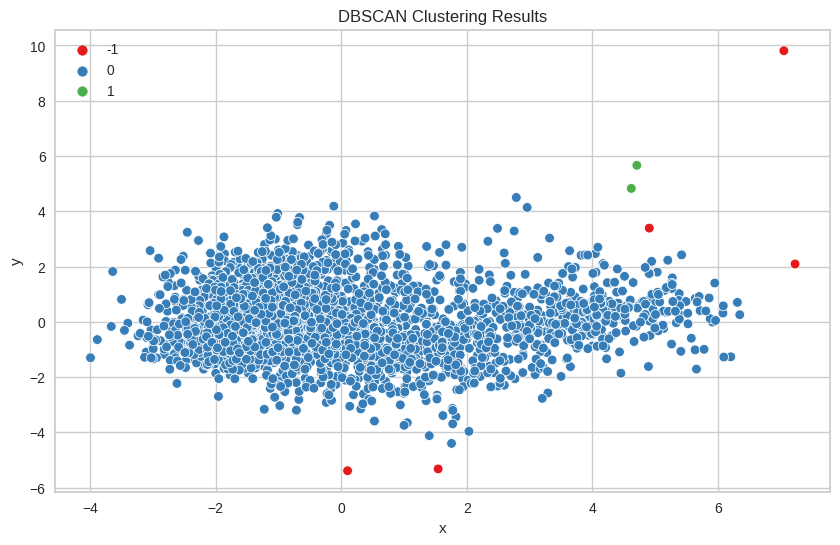

In [282]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x=projection1['x'], y=projection1['y'], hue=cluster_assignments, palette='Set1')
plt.title('DBSCAN Clustering Results')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.show()

#### Conclusão do DBSCAN

Analisando o gráfico acima, podemos notar que a grande maioria dos dados foram alocados para o cluster em azul. Mesmo quando tentamos otimizar os valores de epsilon e min_sample, temos uma clusterização semelhante a acima. Isto nos leva a concluir que, devido a densidade uniforme dos nossos dados, que pode ser notada pelo gráfico, o algoritmo DBSCAN não é o mais adequado para o propósito.

### *HDBSCAN*

Podemos aplicar mais um modelo de clusterização, neste caso, o HDBSCAN.

Este modelo é caracterizado pela formação de hierarquias com a alteração e manipulação da densidade mínima para formação dos clusters à cada nível da dada hierarquia, veremos mais para frente que é possível a representação desta formação através de estruturas como os dendogramas.

Para a aplicação do algoritmo, utilizaremos novamente os dados que sofreram tratamento através do pipeline.

In [283]:
columns_to_drop = ['genero', 'cluster_pca']
projection2 = projection.drop(columns=columns_to_drop, axis=1)

projection2

,x,y
0,5.910268,-0.011146
1,2.787093,4.498483
2,-0.757538,-1.258495
3,1.020521,-0.931690
4,0.753911,-0.999861
...,...,...
2968,-0.475136,-0.017126
2969,-3.026756,-1.304983
2970,-0.832511,-1.089726
2971,1.774790,-3.695233


#### Instalação

No caso do HDBSCAN, é necessário realizar sua instalação e importação à parte da biblioteca sklearn para aplicá-lo.



In [284]:
!pip install hdbscan

Defaulting to user installation because normal site-packages is not writeable


#### Métricas de Validação e Parâmetros Principais

Quanto às métricas de validação utilizadas, resolveu-se fazer uso do conhecido **Davies Bouldin Index** e o **DBCV**(Density-Based Clustering Validation).

##### *DBCV*

O DBCV é uma métrica específica para métodos de clusterização baseados em densidade e cujo cálculo é propriamente realizado pelo próprio HDBSCAN, sendo representado por ```hdbscan.HDBSCAN.relative_validity_```.

A ideia central desta métrica envolve a **Esparsidade de Densidade** e **Separação de Densidade** dos clusters, ou seja, quão boa é a capacidade do modelo de identificar regiões de baixa e alta densidade de acordo com os parâmetros.

A fórmula do DBCV é representada como:
<center> $\sum_{i=1}^{i=l}\frac{\mid C_i \mid}{\mid O \mid} ⋅ V_c(C_i)$</center>
Onde:


*   $V_C$ : Corresponde ao índice de validade de um dado cluster $C_i$.

Quanto a questão de valores, o DBCV tem seu resultado pertencente à uma faixa de valores entre -1 e 1, quanto maior o valor, ou seja, quanto mais próximo de 1, o processo de clusterização é considerado como melhor.

##### *Parâmetros Principais*

No que diz respeito ao HDBSCAN, os principais parâmetros do modelo a serem analisado são ```min_cluster_size``` e ```min_samples```.

Nos quais:

*   ```min_cluster_size```: Se refere à quantidade mínima de objetos que um grupo deve conter para ser considerado um cluster.

*   ```min_samples```: Define a quantidade mínima de vizinhos que uma sample deve conter para ser considerada um núcleo.

Estas foram as 2 principais métricas analisadas durante o processo de Validação realizado no HDBSCAN.








In [285]:
import hdbscan
from sklearn.metrics import davies_bouldin_score
import matplotlib.pyplot as plt

In [286]:
# # Demora bastante para concluir! 

# min_cluster_size_values = range(5,56)
# min_samples_values = range(5, 36)

# davies_bouldin_scores1 = []
# dbcv_scores =[]

# #Análise dos Scores para cada valor possível dos parâmetros principais
# for min_cluster_size in min_cluster_size_values:
#   for min_samples in min_samples_values:
#     hierarchical_dbscan = hdbscan.HDBSCAN(gen_min_span_tree=True, min_cluster_size=min_cluster_size, min_samples=min_samples, cluster_selection_epsilon = 0.0, alpha = 1.0)
#     hierarchical_dbscan.fit(projection2)
#     cluster_assignments = hierarchical_dbscan.labels_
#     db_index = davies_bouldin_score(projection2, cluster_assignments)
#     dbcv_score = hierarchical_dbscan.relative_validity_
#     davies_bouldin_scores1.append(db_index)
#     dbcv_scores.append(dbcv_score)
# davies_bouldin_scores1 = np.array(davies_bouldin_scores1).reshape(len(min_cluster_size_values), len(min_samples_values))
# dbcv_scores = np.array(dbcv_scores).reshape(len(min_cluster_size_values), len(min_samples_values))

# #Plotagem da figura com os dados para cada um dos parâmetros
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 2)
# plt.imshow(dbcv_scores, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(min_cluster_size_values)), min_cluster_size_values)
# plt.xlabel('Min Samples')
# plt.ylabel('Min Cluster Size')
# plt.title('DBCV Scores')
# plt.colorbar()

# plt.subplot(1, 2, 1)
# plt.imshow(davies_bouldin_scores1, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(min_cluster_size_values)), min_cluster_size_values)
# plt.xlabel('Min Samples')
# plt.ylabel('Min Cluster Size')
# plt.title('Davies Bouldin Indexes')
# plt.colorbar()

# plt.tight_layout()
# plt.show()

Após o processo de Validação foi realizada uma nova aplicação do modelo HDBSCAN, desta vez, com os parâmetros cujos scores foram avaliados como melhores na análise tanto do DBCV quanto do Davies-Bouldin Index.

A partir deste, é possível a montagem de um dendograma que permita a análise e amostragem de como ocorreu o processo de agrupamento em cada nível hierárquico do HDBSCAN.

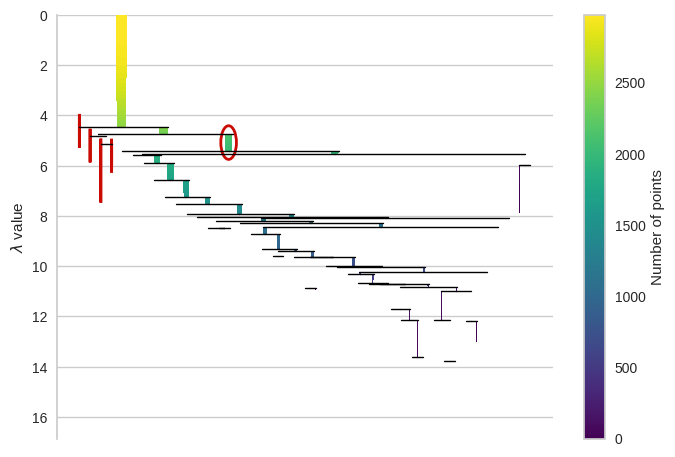

In [287]:
projection2 = projection.drop(columns=columns_to_drop, axis=1)

hierarchical_dbscan = hdbscan.HDBSCAN(min_cluster_size=13, min_samples=6, cluster_selection_epsilon = 0.0, alpha = 0.5)

hierarchical_dbscan.fit(projection2)
#Geração do dendograma
hierarchical_dbscan.condensed_tree_.plot(select_clusters=True)

cluster_assignments = hierarchical_dbscan.labels_

data_genre = dados_generos.drop(columns='cluster_pca', axis=1)
data_genre['cluster_hdbscan'] = cluster_assignments
projection2['cluster_hdbscan'] = cluster_assignments

In [288]:
projection2['generos'] = data_genre['genres']
projection2

,x,y,cluster_hdbscan,generos
0,5.910268,-0.011146,-1,21st century classical
1,2.787093,4.498483,-1,432hz
2,-0.757538,-1.258495,1,8-bit
3,1.020521,-0.931690,1,[]
4,0.753911,-0.999861,1,a cappella
...,...,...,...,...
2968,-0.475136,-0.017126,1,zolo
2969,-3.026756,-1.304983,-1,zouglou
2970,-0.832511,-1.089726,1,zouk
2971,1.774790,-3.695233,-1,zurich indie


In [289]:
import plotly.express as px

Realizando um Scatter Plot, é possível observar como ficou a distribuição dos dados e seus agrupamentos.

É de extrema importância observar que a organização dos dados se encontra extremamente condensada em uma dada área do plano, tornando-a suscetível para uma classificação em um único grupo pelos algoritmos de densidade.

In [290]:
fig = px.scatter(
    projection2, x = 'x', y='y', color='cluster_hdbscan', hover_data=['x', 'y', 'generos']
)
fig.show()

#### K-means com PCA

Quando lidamos com um problema de agrupamento, queremos usar um algoritmo que descubra grupos significativos nos dados, como é o nosso caso, agrupar gêneros musicais e músicas. Seja para qualquer outro fim, o algoritmo descobre os grupos sem intervenções externas, já que não precisa de rótulos para realizar previsões.

Sabendo disso, o K-means tenta organizar os dados em um número k de clusters, que definimos inicialmente, e, a partir disso, ele identifica os pontos de dados semelhantes e vai criando agrupamentos, tentando distanciar cada cluster o máximo possível. O cálculo das semelhanças é feito utilizando a distância euclidiana ou uma linha reta comum entre dois pontos. Quanto menor a distância euclidiana, mais próximo os dois pontos estão e mais semelhantes eles são por consequência.

O processo de como o K-means funciona é relativamente simples e repetitivo.

1. O usuário define o valor de clusters (k);
2. O K-means seleciona um ponto aleatório para cada centróide, temos k-centróides nesse ponto, e um centróide é o ponto em torno do qual cada cluster é construído;
3. A distância euclidiana é calculada entre cada ponto e cada centróide, e, a partir disto, cada ponto será atribuído a um centróide (mais próximo com base na distância euclidiana);
4. O algoritmo calcula a média da distância euclidiana entre cada ponto do cluster e o centróide para definir um novo centróide;
5. O processo 4 se repete até que os centróides dos clusters não se movam mais.

Existe um site onde podemos ver uma animação de como esse processo acontece, ele se chama [K-Means Clustering Demo](https://user.ceng.metu.edu.tr/~akifakkus/courses/ceng574/k-means/).

Porém, nem tudo é extremamente bom no K-means, ele ainda não consegue resolver problemas com escalas diferentes e também não consegue agrupar com precisão dados de alta dimensionalidade.

Para a primeira parte, em relação às escalas, é necessário que todos estejam na mesma escala de [0,1], como fizemos anteriormente com o StandardScaler, caso contrário, ele colocará maior peso em variáveis que têm variâncias maiores e esses recursos terão maior influência na forma final do cluster.

Em relação à alta dimensionalidade, o algoritmo usa a distância euclidiana para determinar a associação de agrupamento, porém, quando temos uma alta dimensionalidade, pares de pontos começarão a ter distâncias muito semelhantes e não conseguiremos obter agrupamentos significativos. Para reduzir a quantidade de dados podemos utilizar a técnica chamada Análise de Componentes Principais (PCA).

PCA é um método clássico usado para reduzir dados de alta dimensionalidade para um espaço de baixa dimensão. Em outras palavras, simplesmente não podemos visualizar com precisão conjuntos de dados de alta dimensão, porque não podemos visualizar nada acima de 3 dimensões (3D). Um dos principais objetivos do PCA é transformar conjuntos de dados com mais de 3 dimensões (alta dimensão) em gráficos tipicamente 2D ou 3D. Essa ação é o que chamamos de espaço de baixa dimensão.

Mesmo fazendo toda a redução de n dimensões existentes para 2D, no nosso caso, ainda conseguimos reter a maior parte da informação necessária do conjunto de dados de alta dimensão, ou seja, a informação foi “espremida” até caber em 2 dimensões.

Então, as informações que eram contidas em n dimensões passam a estar em 2 componentes principais (PC). O primeiro PC contém a maioria das informações dos recursos originais, o segundo PC conterá a próxima maior quantidade de informações, e, caso tivéssemos mais PC 's, seria essa mesma sequência, sendo os PC’s não correlacionados entre si, o que significa que cada um guarda informações únicas.

Usando os dois módulos de auxílio, a padronização dos dados com o StandardScaler e a redução de dimensionalidade com o PCA, quando necessário, os resultados obtidos com o K-Means serão melhores do que apenas aplicar ele diretamente nos dados.

### Plotando a clustering

In [291]:
fig = px.scatter(
    projection, x = 'x', y='y', color='cluster_pca', hover_data=['x', 'y', 'genero']
)
fig.show()

In [292]:
pca_pipeline[1].explained_variance_ratio_.sum() # porcentagem dos dados que está sendo explicado

0.4927066994726645

In [293]:
pca_pipeline[1].explained_variance_.sum() # colunas que estão sendo explicadas

5.421597305805701

## Clusterização por música

Método utilitário para plotar o gráfico com os clusters gerados.

In [294]:
from sklearn.decomposition import PCA

def plotar_clusters(titulo, labels):
  pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
  X = dados.select_dtypes(np.number)
  song_embedding = pca_pipeline.fit_transform(X)
  projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
  projection['title'] = dados['name']
  projection['cluster'] = labels

  fig = px.scatter(
      projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'],
      title=titulo)
  fig.show()

### Análise e pipeline

In [295]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [296]:
dados.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,id,instrumentalness,liveness,loudness,name,popularity,speechiness,tempo,artists_song
0,0.285,2000,0.00239,Coldplay,0.429,266773,0.661,3AJwUDP919kvQ9QcozQPxg,0.000121,0.2340,-7.227,Yellow,84,0.0281,173.372,Coldplay - Yellow
1,0.613,2000,0.14300,OutKast,0.843,270507,0.806,0I3q5fE6wg7LIfHGngUTnV,0.000000,0.0771,-5.946,Ms. Jackson,80,0.2690,94.948,OutKast - Ms. Jackson
2,0.400,2000,0.00958,Linkin Park,0.556,216880,0.864,60a0Rd6pjrkxjPbaKzXjfq,0.000000,0.2090,-5.870,In the End,84,0.0584,105.143,Linkin Park - In the End
3,0.543,2000,0.00664,3 Doors Down,0.545,233933,0.865,6ZOBP3NvffbU4SZcrnt1k6,0.000011,0.1680,-5.708,Kryptonite,78,0.0286,99.009,3 Doors Down - Kryptonite
4,0.760,2000,0.03020,Eminem,0.949,284200,0.661,3yfqSUWxFvZELEM4PmlwIR,0.000000,0.0454,-4.244,The Real Slim Shady,80,0.0572,104.504,Eminem - The Real Slim Shady


In [297]:
dados['artists'].value_counts()

artists
Drake                   170
Taylor Swift            156
Eminem                  147
Kanye West              136
BTS                     122
                       ... 
Of Monsters and Men       7
The Living Tombstone      7
Clean Bandit              7
Nelly Furtado             6
Empire of the Sun         6
Name: count, Length: 875, dtype: int64

In [298]:
dados['artists_song'].value_counts()

artists_song
Coldplay - Yellow                                                   1
Juice WRLD - Intro                                                  1
Carrie Underwood - The Champion - Bonus Track                       1
YoungBoy Never Broke Again - Cross Me (feat. Lil Baby and Plies)    1
Twenty One Pilots - Morph                                           1
                                                                   ..
Taylor Swift - Come Back...Be Here                                  1
Banda El Recodo - Me Gusta Todo De Ti                               1
Michael Bublé - The Christmas Song                                  1
Glee Cast - Smooth Criminal (Glee Cast Version) (feat. 2CELLOS)     1
Eminem - Darkness                                                   1
Name: count, Length: 20311, dtype: int64

Escolhemos aplicar dummies com o OneHotEncoder na coluna 'artists' pois contem bem menos valores unicos que a coluna 'artists_song', logo nao perderemos a caracteristica dos dados visto que mantemos os nomes dos artistas que de certa forma tem correlacao com a musica registrada.

In [299]:
from sklearn.preprocessing import OneHotEncoder

ohe = OneHotEncoder(dtype=int)
colunas_ohe = ohe.fit_transform(dados[['artists']]).toarray()
dados2 = dados.drop('artists', axis=1)

dados_musicas_dummies = pd.concat([dados2,
                                   pd.DataFrame(colunas_ohe,
                                                columns=ohe.get_feature_names_out(['artists']))]
                                  , axis=1)
dados_musicas_dummies

,valence,year,acousticness,danceability,duration_ms,energy,id,instrumentalness,liveness,loudness,...,artists_Zara Larsson,artists_Zedd,artists_alt-J,artists_blackbear,artists_blink-182,artists_deadmau5,artists_for KING & COUNTRY,artists_fun.,artists_girl in red,artists_iann dior
0,0.285,2000,0.00239,0.429,266773,0.661,3AJwUDP919kvQ9QcozQPxg,0.000121,0.2340,-7.227,...,0,0,0,0,0,0,0,0,0,0
1,0.613,2000,0.14300,0.843,270507,0.806,0I3q5fE6wg7LIfHGngUTnV,0.000000,0.0771,-5.946,...,0,0,0,0,0,0,0,0,0,0
2,0.400,2000,0.00958,0.556,216880,0.864,60a0Rd6pjrkxjPbaKzXjfq,0.000000,0.2090,-5.870,...,0,0,0,0,0,0,0,0,0,0
3,0.543,2000,0.00664,0.545,233933,0.865,6ZOBP3NvffbU4SZcrnt1k6,0.000011,0.1680,-5.708,...,0,0,0,0,0,0,0,0,0,0
4,0.760,2000,0.03020,0.949,284200,0.661,3yfqSUWxFvZELEM4PmlwIR,0.000000,0.0454,-4.244,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20306,0.187,2020,0.57400,0.445,176250,0.330,0PUkanqCGTb6qseXPKOw1F,0.000000,0.1020,-8.121,...,0,0,0,0,0,0,0,0,0,0
20307,0.240,2020,0.81500,0.467,179188,0.429,6Iw6fQVKZi0fWtEQBrTFcP,0.000052,0.1770,-8.689,...,0,0,0,0,0,0,0,0,0,0
20308,0.466,2020,0.31000,0.562,253613,0.686,308prODCCD0O660tIktbUi,0.022500,0.1250,-8.480,...,0,0,0,0,0,0,0,0,0,0
20309,0.522,2020,0.20400,0.598,230600,0.472,2f8y4CuG57UJEmkG3ujd0D,0.000015,0.1080,-10.991,...,0,0,0,0,0,0,0,0,0,0


In [300]:
dados.shape

(20311, 16)

In [301]:
dados_musicas_dummies.shape

(20311, 890)

In [302]:
X = dados.select_dtypes(np.number)
pca_pipeline = Pipeline([('scaler', StandardScaler())])
music_embedding_pca = pca_pipeline.fit_transform(X)
projection_m = pd.DataFrame(data = music_embedding_pca)
projection_m

,0,1,2,3,4,5,6,7,8,9,10,11
0,-0.799201,-1.679338,-0.845293,-0.926357,0.541330,0.046147,-0.301298,0.253534,-0.033311,2.383783,-0.683616,1.662034
1,0.531933,-1.679338,-0.350899,1.490202,0.594322,0.699981,-0.301905,-0.741052,0.263217,2.037782,1.587798,-0.878884
2,-0.332492,-1.679338,-0.820013,-0.185046,-0.166738,0.961515,-0.301905,0.095060,0.280809,2.383783,-0.397922,-0.548569
3,0.247849,-1.679338,-0.830350,-0.249254,0.075273,0.966025,-0.301850,-0.164839,0.318309,1.864782,-0.678902,-0.747309
4,1.128508,-1.679338,-0.747511,2.108935,0.788650,0.046147,-0.301905,-0.941998,0.657199,2.037782,-0.409236,-0.569272
...,...,...,...,...,...,...,...,...,...,...,...,...
20306,-1.196917,1.618914,1.164525,-0.832964,-0.743349,-1.446400,-0.301905,-0.583212,-0.240256,1.086280,-0.544069,0.192803
20307,-0.981826,1.618914,2.011897,-0.704548,-0.701654,-0.999989,-0.301643,-0.107788,-0.371738,0.740279,-0.039625,0.857160
20308,-0.064642,1.618914,0.236284,-0.150023,0.354567,0.158877,-0.189016,-0.437415,-0.323358,0.826779,-0.713789,-0.616252
20309,0.162624,1.618914,-0.136419,0.060113,0.027972,-0.806093,-0.301828,-0.545178,-0.904609,0.826779,1.484081,-0.064614


#### OneHotEncoder e get_dummies

Ao trabalharmos com variáveis categóricas em modelos de machine learning, deve-se realizar sua transformação para variáveis binárias, também conhecidas como variáveis dummies. Esse processo denomina-se codificação “one-hot” ou codificação distribuída que transforma seus dados categóricos em uma representação vetorial binária, ou seja, para cada valor único em uma coluna, uma nova coluna é criada. Os valores nesta nova coluna são representados como 1s e 0s.

Essa codificação pode ser realizada de forma automática com o método get_dummies() da biblioteca pandas ou ainda com o método OneHotEncoder da biblioteca sklearn. Mas qual devemos utilizar?

Para modelos de machine learning, é sempre preferível utilizar o OneHotEncoder, caso seja apenas uma analise mais simples pode-se utilizar o get_dummies(). A grande vantagem é que o sklearn cria um transformador que pode ser aplicado a um novo conjunto de dados que tenham as mesmas features categoricas, logo pode-se utilizar esse transformador em um pipeline do sklearn para tornar o processo ainda mais automatizado.

Outra vantagem do OneHotEncoder é que com esse método é possível lidar com categorias desconhecidas durante a transformação nativa através do parâmetro handle_unknown, caso fosse utilizado o método get_dummies() isso não seria possível.

Diante disso, podemos concluir que os dois métodos retornam os mesmos resultados, então sua utilização depende de qual contexto está sendo trabalhado. Caso o processo seja para criação de modelos de machine learning, é preferível utilizar o OneHotEncoder e para atividades de análise de dados pode-se utilizar o get_dummies sem perda produtividade.

### Aplicação do cluster com K-Means

#### Método do cotovelo

In [303]:
from sklearn import metrics
import matplotlib.pyplot as plt

X = dados.select_dtypes(np.number)

pipeline = Pipeline([('scaler', StandardScaler())])
music_embedding = pipeline.fit_transform(X)
X_normalizado = pd.DataFrame(data = music_embedding)

Text(0, 0.5, 'WCSS')

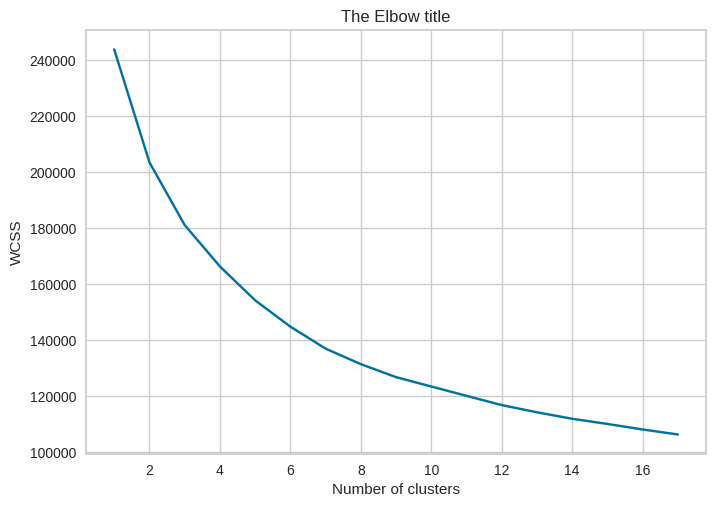

In [304]:
wcss=[]
for i in range(1,18):
    kmeans = KMeans(n_init=10, n_clusters=i)
    kmeans.fit(X_normalizado)
    wcss_iter = kmeans.inertia_
    wcss.append(wcss_iter)

number_clusters = range(1,18)
plt.plot(number_clusters,wcss)
plt.title('The Elbow title')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')

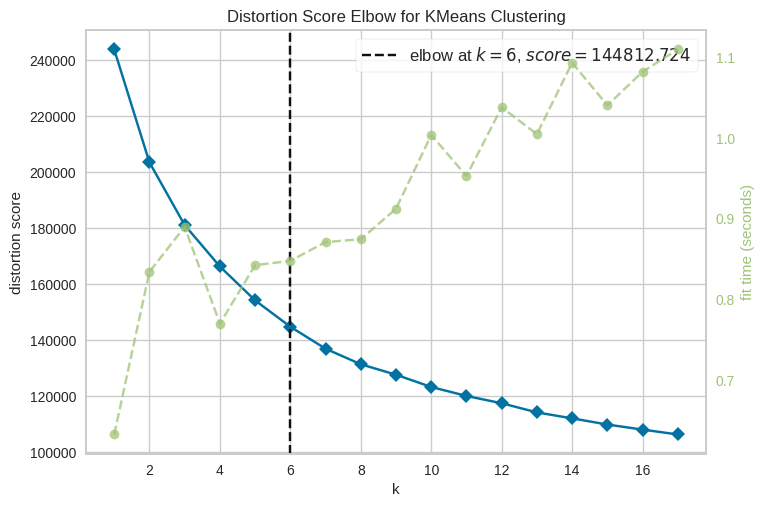

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [305]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn import metrics

X = dados.select_dtypes(np.number)

pipeline = Pipeline([('scaler', StandardScaler())])
music_embedding = pipeline.fit_transform(X)
X_normalizado = pd.DataFrame(data = music_embedding)

kmeans_dados_elbow = KMeans(n_init=10)

# distorção: média das distâncias quadradas dos centros dos clusters dos respectivos clusters
grafico = KElbowVisualizer(kmeans_dados_elbow, k=(1,18))

grafico.fit(X_normalizado)
grafico.show()

#### Aplicando

In [306]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

kmeans_pca_pipeline = KMeans(n_clusters=6, random_state=42)
kmeans_pca_pipeline.fit(projection_m)


dados['cluster_pca'] = kmeans_pca_pipeline.predict(projection_m)
projection_m['cluster_pca'] = kmeans_pca_pipeline.predict(projection_m)

/home/vini/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [307]:
projection_m['artist'] = dados['artists']
projection_m['song'] = dados['artists_song']

projection_m

,0,1,2,3,4,5,6,7,8,9,10,11,cluster_pca,artist,song
0,-0.799201,-1.679338,-0.845293,-0.926357,0.541330,0.046147,-0.301298,0.253534,-0.033311,2.383783,-0.683616,1.662034,4,Coldplay,Coldplay - Yellow
1,0.531933,-1.679338,-0.350899,1.490202,0.594322,0.699981,-0.301905,-0.741052,0.263217,2.037782,1.587798,-0.878884,2,OutKast,OutKast - Ms. Jackson
2,-0.332492,-1.679338,-0.820013,-0.185046,-0.166738,0.961515,-0.301905,0.095060,0.280809,2.383783,-0.397922,-0.548569,4,Linkin Park,Linkin Park - In the End
3,0.247849,-1.679338,-0.830350,-0.249254,0.075273,0.966025,-0.301850,-0.164839,0.318309,1.864782,-0.678902,-0.747309,4,3 Doors Down,3 Doors Down - Kryptonite
4,1.128508,-1.679338,-0.747511,2.108935,0.788650,0.046147,-0.301905,-0.941998,0.657199,2.037782,-0.409236,-0.569272,1,Eminem,Eminem - The Real Slim Shady
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20306,-1.196917,1.618914,1.164525,-0.832964,-0.743349,-1.446400,-0.301905,-0.583212,-0.240256,1.086280,-0.544069,0.192803,3,Bazzi,Bazzi - I Don't Think I'm Okay
20307,-0.981826,1.618914,2.011897,-0.704548,-0.701654,-0.999989,-0.301643,-0.107788,-0.371738,0.740279,-0.039625,0.857160,3,Bryson Tiller,Bryson Tiller - Timeless Interlude
20308,-0.064642,1.618914,0.236284,-0.150023,0.354567,0.158877,-0.189016,-0.437415,-0.323358,0.826779,-0.713789,-0.616252,0,Fleet Foxes,Fleet Foxes - Sunblind
20309,0.162624,1.618914,-0.136419,0.060113,0.027972,-0.806093,-0.301828,-0.545178,-0.904609,0.826779,1.484081,-0.064614,2,Gunna,Gunna - NASTY GIRL / ON CAMERA


### Analisando o cluster

In [308]:
import plotly.express as px

plotar_clusters('Clusters das músicas - KMeans', projection_m['cluster_pca'])

## DBSCAN


In [309]:
columns_to_drop = ['artist', 'song', 'cluster_pca']
projection_n = projection_m.drop(columns=columns_to_drop, axis=1)

projection_n.columns = projection_n.columns.astype(str)

projection_n

,0,1,2,3,4,5,6,7,8,9,10,11
0,-0.799201,-1.679338,-0.845293,-0.926357,0.541330,0.046147,-0.301298,0.253534,-0.033311,2.383783,-0.683616,1.662034
1,0.531933,-1.679338,-0.350899,1.490202,0.594322,0.699981,-0.301905,-0.741052,0.263217,2.037782,1.587798,-0.878884
2,-0.332492,-1.679338,-0.820013,-0.185046,-0.166738,0.961515,-0.301905,0.095060,0.280809,2.383783,-0.397922,-0.548569
3,0.247849,-1.679338,-0.830350,-0.249254,0.075273,0.966025,-0.301850,-0.164839,0.318309,1.864782,-0.678902,-0.747309
4,1.128508,-1.679338,-0.747511,2.108935,0.788650,0.046147,-0.301905,-0.941998,0.657199,2.037782,-0.409236,-0.569272
...,...,...,...,...,...,...,...,...,...,...,...,...
20306,-1.196917,1.618914,1.164525,-0.832964,-0.743349,-1.446400,-0.301905,-0.583212,-0.240256,1.086280,-0.544069,0.192803
20307,-0.981826,1.618914,2.011897,-0.704548,-0.701654,-0.999989,-0.301643,-0.107788,-0.371738,0.740279,-0.039625,0.857160
20308,-0.064642,1.618914,0.236284,-0.150023,0.354567,0.158877,-0.189016,-0.437415,-0.323358,0.826779,-0.713789,-0.616252
20309,0.162624,1.618914,-0.136419,0.060113,0.027972,-0.806093,-0.301828,-0.545178,-0.904609,0.826779,1.484081,-0.064614


In [310]:
# # Demora bastante! 

# eps_values = np.linspace(0.1, 2.0, num=20)
# min_samples_values = range(2, 11)

# silhouette_scores = []
# davies_bouldin_scores = []
# parameter_combinations = []

# for eps in eps_values:
#     for min_samples in min_samples_values:
#         dbscan = DBSCAN(eps=eps, min_samples=min_samples)
#         dbscan.fit(projection_n)
#         cluster_assignments = dbscan.labels_


#         num_unique_labels = len(np.unique(cluster_assignments))
#         if num_unique_labels == 1:
#             silhouette_avg = -1
#             db_index = 10
#         else:
#             silhouette_avg = silhouette_score(projection_n, cluster_assignments)
#             db_index = davies_bouldin_score(projection_n, cluster_assignments)

#         silhouette_scores.append(silhouette_avg)
#         davies_bouldin_scores.append(db_index)

# silhouette_scores = np.array(silhouette_scores).reshape(len(eps_values), len(min_samples_values))
# davies_bouldin_scores = np.array(davies_bouldin_scores).reshape(len(eps_values), len(min_samples_values))

# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 1)
# plt.imshow(silhouette_scores, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(eps_values)), ["{:.2f}".format(eps) for eps in eps_values])
# plt.xlabel('Min Samples')
# plt.ylabel('Epsilon')
# plt.title('Silhouette Scores')
# plt.colorbar()

# plt.subplot(1, 2, 2)
# plt.imshow(davies_bouldin_scores, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(eps_values)), ["{:.2f}".format(eps) for eps in eps_values])
# plt.xlabel('Min Samples')
# plt.ylabel('Epsilon')
# plt.title('Davies-Bouldin Scores')
# plt.colorbar()

# plt.tight_layout()
# plt.show()

Analisando os gráficos, podemos notar que o índice de David-Bouldin apresenta bom resultado para quase todo epsilon no range definido, entretando, temos resultados ótimos em ambos gráficos para epsilon entre 0.25 e 0.65

In [311]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.3, min_samples=3)

dbscan.fit(projection_n)

cluster_assignments = dbscan.labels_

projection_n['cluster_dbscan'] = cluster_assignments

cluster_counts = np.bincount(cluster_assignments[cluster_assignments >= 0])

for cluster_id, count in enumerate(cluster_counts):
    if cluster_id != -1:
        print(f"Cluster {cluster_id}: {count} objects")

Cluster 0: 3 objects
Cluster 1: 6 objects


In [312]:
X = projection_m.select_dtypes(np.number)

silhouette_avg = silhouette_score(X, cluster_assignments)

db_index = davies_bouldin_score(X, cluster_assignments)

print("Silhouette Score:", silhouette_avg)
print("Davies-Bouldin Index:", db_index)

Silhouette Score: 0.5084506062077516
Davies-Bouldin Index: 0.6354845566388018


In [313]:
plotar_clusters('Clusters das músicas - DBSCAN', projection_n['cluster_dbscan'])

## *HDBSCAN*

In [314]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

#### Métodos de Avaliação e Parâmetros

Nesta nova aplicação do HDBSCAN é notável observar que apresentamos uma quantidade muito maior de *samples* para análise. Contudo, é necessário observar como se encontra a distribuição destes objetos, de tal modo, podemos analisar como o agrupamento pro densidade pode ser afetado de acorod com sua organização.

Optou-se por manter os métodos já aplicados anteriormente durante a clusterização de dados referentes a gêneros musicais, ou seja, manteve-se o uso do **Davies-Bouldin Index** e do **DBCV**.

Da mesma maneira, os parâmetros principais do HDBSCAN se mantém os mesmos para validação, sendo eles ```min_cluster_size``` e ```min_samples```.

In [315]:
columns_to_drop = ['artist', 'song', 'cluster_pca']
projection_n1 = projection_m.drop(columns=columns_to_drop, axis=1)

projection_n1.columns = projection_n1.columns.astype(str)

projection_n1

,0,1,2,3,4,5,6,7,8,9,10,11
0,-0.799201,-1.679338,-0.845293,-0.926357,0.541330,0.046147,-0.301298,0.253534,-0.033311,2.383783,-0.683616,1.662034
1,0.531933,-1.679338,-0.350899,1.490202,0.594322,0.699981,-0.301905,-0.741052,0.263217,2.037782,1.587798,-0.878884
2,-0.332492,-1.679338,-0.820013,-0.185046,-0.166738,0.961515,-0.301905,0.095060,0.280809,2.383783,-0.397922,-0.548569
3,0.247849,-1.679338,-0.830350,-0.249254,0.075273,0.966025,-0.301850,-0.164839,0.318309,1.864782,-0.678902,-0.747309
4,1.128508,-1.679338,-0.747511,2.108935,0.788650,0.046147,-0.301905,-0.941998,0.657199,2.037782,-0.409236,-0.569272
...,...,...,...,...,...,...,...,...,...,...,...,...
20306,-1.196917,1.618914,1.164525,-0.832964,-0.743349,-1.446400,-0.301905,-0.583212,-0.240256,1.086280,-0.544069,0.192803
20307,-0.981826,1.618914,2.011897,-0.704548,-0.701654,-0.999989,-0.301643,-0.107788,-0.371738,0.740279,-0.039625,0.857160
20308,-0.064642,1.618914,0.236284,-0.150023,0.354567,0.158877,-0.189016,-0.437415,-0.323358,0.826779,-0.713789,-0.616252
20309,0.162624,1.618914,-0.136419,0.060113,0.027972,-0.806093,-0.301828,-0.545178,-0.904609,0.826779,1.484081,-0.064614


In [316]:
# # Demora bastante!

# min_cluster_size_values = range(5,21)
# min_samples_values = range(5, 16)

# davies_bouldin_scores1 = []
# dbcv_scores = []
# #Aplicação do método de validação
# for min_cluster_size in min_cluster_size_values:
#   for min_samples in min_samples_values:
#     hierarchical_dbscan = hdbscan.HDBSCAN(gen_min_span_tree=True, min_cluster_size=min_cluster_size, min_samples=min_samples, cluster_selection_epsilon = 0.0, alpha = 1.0)
#     hierarchical_dbscan.fit(projection_n1)
#     cluster_assignments = hierarchical_dbscan.labels_
#     db_index = davies_bouldin_score(projection_n1, cluster_assignments)
#     dbcv_score = hierarchical_dbscan.relative_validity_
#     davies_bouldin_scores1.append(db_index)
#     dbcv_scores.append(dbcv_score)
#     print('min_samples: ', min_samples, ', min_cluster_size: ', min_cluster_size)
# davies_bouldin_scores1 = np.array(davies_bouldin_scores1).reshape(len(min_cluster_size_values), len(min_samples_values))
# dbcv_scores = np.array(dbcv_scores).reshape(len(min_cluster_size_values), len(min_samples_values))
# #Plotar para comparação de resultados
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 2)
# plt.imshow(davies_bouldin_scores1, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(min_cluster_size_values)), min_cluster_size_values)
# plt.xlabel('Min Samples')
# plt.ylabel('Min Cluster Size')
# plt.title('Davies-Bouldin Scores')
# plt.colorbar()

# plt.subplot(1, 2, 1)
# plt.imshow(dbcv_scores, cmap='viridis', aspect='auto', origin='lower')
# plt.xticks(np.arange(len(min_samples_values)), min_samples_values)
# plt.yticks(np.arange(len(min_cluster_size_values)), min_cluster_size_values)
# plt.xlabel('Min Samples')
# plt.ylabel('Min Cluster Size')
# plt.title('DBCV Scores')
# plt.colorbar()

# plt.tight_layout()
# plt.show()

Podemos novamente aplicar os melhores valores possíveis para os parâmetros e gerar um dendograma para análise de agrupamento.

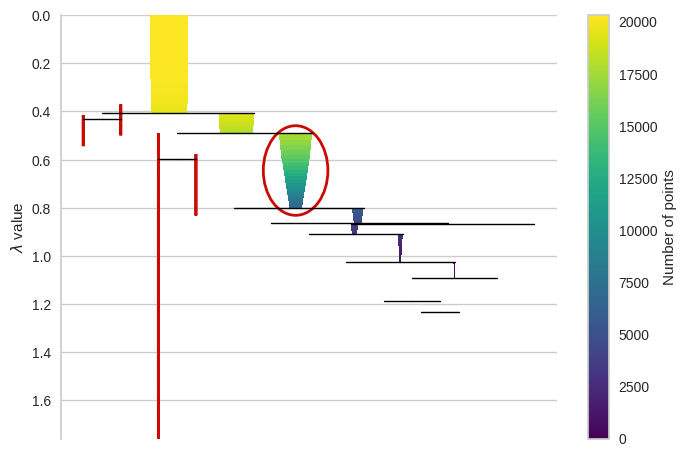

In [317]:
columns_to_drop = ['artist', 'song', 'cluster_pca']
projection_n1 = projection_m.drop(columns=columns_to_drop, axis=1)

projection_n1.columns = projection_n1.columns.astype(str)

projection_n1

#Aplicação do HDBSCAN
hierarchical_dbscan = hdbscan.HDBSCAN(min_cluster_size=5, min_samples=13, cluster_selection_epsilon = 0.0, alpha = 1.0)

hierarchical_dbscan.fit(projection_n1)

#Gerando o Dendograma
hierarchical_dbscan.condensed_tree_.plot(select_clusters=True)

cluster_assignments = hierarchical_dbscan.labels_

data_music = dados.drop(columns='cluster_pca', axis=1)
data_music['cluster_hdbscan'] = cluster_assignments

projection_n1['cluster_hdbscan'] = cluster_assignments


In [318]:
projection_n1['artist'] = data_music['artists']
projection_n1['song'] = data_music['artists_song']

projection_n1

,0,1,2,3,4,5,6,7,8,9,10,11,cluster_hdbscan,artist,song
0,-0.799201,-1.679338,-0.845293,-0.926357,0.541330,0.046147,-0.301298,0.253534,-0.033311,2.383783,-0.683616,1.662034,-1,Coldplay,Coldplay - Yellow
1,0.531933,-1.679338,-0.350899,1.490202,0.594322,0.699981,-0.301905,-0.741052,0.263217,2.037782,1.587798,-0.878884,2,OutKast,OutKast - Ms. Jackson
2,-0.332492,-1.679338,-0.820013,-0.185046,-0.166738,0.961515,-0.301905,0.095060,0.280809,2.383783,-0.397922,-0.548569,2,Linkin Park,Linkin Park - In the End
3,0.247849,-1.679338,-0.830350,-0.249254,0.075273,0.966025,-0.301850,-0.164839,0.318309,1.864782,-0.678902,-0.747309,2,3 Doors Down,3 Doors Down - Kryptonite
4,1.128508,-1.679338,-0.747511,2.108935,0.788650,0.046147,-0.301905,-0.941998,0.657199,2.037782,-0.409236,-0.569272,2,Eminem,Eminem - The Real Slim Shady
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20306,-1.196917,1.618914,1.164525,-0.832964,-0.743349,-1.446400,-0.301905,-0.583212,-0.240256,1.086280,-0.544069,0.192803,2,Bazzi,Bazzi - I Don't Think I'm Okay
20307,-0.981826,1.618914,2.011897,-0.704548,-0.701654,-0.999989,-0.301643,-0.107788,-0.371738,0.740279,-0.039625,0.857160,2,Bryson Tiller,Bryson Tiller - Timeless Interlude
20308,-0.064642,1.618914,0.236284,-0.150023,0.354567,0.158877,-0.189016,-0.437415,-0.323358,0.826779,-0.713789,-0.616252,2,Fleet Foxes,Fleet Foxes - Sunblind
20309,0.162624,1.618914,-0.136419,0.060113,0.027972,-0.806093,-0.301828,-0.545178,-0.904609,0.826779,1.484081,-0.064614,2,Gunna,Gunna - NASTY GIRL / ON CAMERA


Podemos novamente plotar uma distribuição dos pontos de acordo com seus grupos.

Torna-se válido lembrar que os elementos apresentam mais de 2 dimensões para seus atributos. Portanto, há a possibilidade de objetos distantes entre si no eixo x e y estarem nos mesmos grupos, afinal, levando em consideração suas outras dimensões não representadas graficamente, há grande semelhança entre os mesmos.

In [319]:
plotar_clusters('Clusters das músicas - HDBSCAN', projection_n1['cluster_hdbscan'])

## Comparação entre os modelos

In [320]:
from sklearn import metrics

X = dados.select_dtypes(np.number)

pipeline = Pipeline([('scaler', StandardScaler())])
music_embedding = pipeline.fit_transform(X)
X_normalizado = pd.DataFrame(data = music_embedding)

### Coeficiente de Silhouette

$$
s(p) = \frac{b - a}{max(a,b)}, \ para \ um \ ponto \ p
$$

Onde $a$ é a distância média entre o ponto e todos os outros pontos do mesmo cluster.


$b$ é a distância média entre o ponto e todos os outros pontos do cluster mais próximo.

$s$ varia entre $[-1, 1]$. Quanto mais próximo de 1 estiver o valor de silhouette mais separados estão os clusters.


**Distância Euclidiana**

Utilizaremos a distância euclidiana para o cálculo da dissimilaridade.

$$
d(A,B) = \sqrt{(x_B - x_A)^2 + (y_B - y_A)^2}
$$

In [321]:
silhouette = metrics.silhouette_score(X, projection_m['cluster_pca'], metric = 'euclidean')
silhouette

-0.11852222675184394

In [322]:
silhouette = metrics.silhouette_score(X, projection_n['cluster_dbscan'], metric = 'euclidean')
silhouette

0.3143704657324148

In [323]:
silhouette = metrics.silhouette_score(X, projection_n1['cluster_hdbscan'], metric = 'euclidean')
silhouette

-0.30925613169971417

### Índice Davies-Bouldin

$$
DB = \frac{1}{k} \sum_{i=1}^k max_{i \neq j} R_{ij}
$$

para $k$ número de clusters.

E onde $R_{ij}$ é a medida de similaridade entre dois clusters $i$ e $j$.

$$
R_{ij} = \frac{s_i + s_j}{d_{ij}}
$$

Para $s_k$ sendo a distância média entre cada ponto de um cluster $k$ e seu **centróide**. (Mede a compactação)

E $d_{kl}$ a distância entre os centróides dos clusters $k$ e $l$. (Mede a separação)

O centróide pode ser encontrado fazendo a média entre as coordenadas dos pontos do cluster.

**Quanto menor o valor do índice DB, melhor é a qualidade do agrupamento**, logo quanto menor os $Rs$ melhor o agrupamento. Um valor próximo de zero indica uma boa separação entre os clusters, com centroides bem definidos e uma dispersão mínima dentro de cada cluster.

É importante observar que o Índice Davies-Bouldin é uma **medida interna** e não leva em consideração informações externas sobre os dados. Portanto, é uma medida útil para comparar diferentes **soluções de agrupamento com base em sua estrutura interna**, mas não fornece uma indicação direta da adequação do agrupamento em relação aos **dados do mundo real**.

In [324]:
dbs = metrics.davies_bouldin_score(X,projection_m['cluster_pca'])
dbs

19.93352278846976

In [325]:
dbs = metrics.davies_bouldin_score(X,projection_n['cluster_dbscan'])
dbs

1.1400542624742158

In [326]:
dbs = metrics.davies_bouldin_score(X,projection_n1['cluster_hdbscan'])
dbs

13.139636196404359

### Índice Calinski-Harabasz



$$
s = \frac{tr(B_k)}{tr(W_k)} \cdot \frac{n_E - k}{k - 1}
$$

$n_E$ é o número de elementos total.

$k$ é o número de clusters.

$B_k$ é a dispersão dos elementos entre (_Between_) clusters. (Mede a separação, quanto maior melhor)

$W_k$ é a dispersão dos elementos dentro (_Within_) dos clusters. (Mede a compactação, quanto menor o $W_k$ maior a compactação)

$$
W_k = \sum_{q=1}^k \sum_{x \in C_q} (x - c_q)(x-c_q)^T
$$

$k$ é o número de clusters.

$q$ é o cluster.

$x$ é o vetor de coordenadas do ponto.

$T$ a transposta da matriz.

Estima uma matriz de variância e covariância.

$$
B_k = \sum_{q=1}^k n_q (c_q - c_E)(c_q - c_E)^T
$$

$n_q$ é o número de elementos no cluster.

$c_q$ é o centróide do cluster.

$c_E$ é o centróide de todos os elementos.

**Quanto maior o valor do Índice Calinski-Harabasz, melhor é a qualidade do agrupamento**. Isso significa que os clusters estão bem separados uns dos outros e que a dispersão dentro de cada cluster é mínima em comparação com a dispersão entre os clusters.

Assim como o índice Davies-Bouldin, o índice Calinski-Harabasz é uma medida interna que não leva em consideração informações externas sobre os dados. Portanto, é útil para comparar diferentes soluções de agrupamento com base em sua estrutura interna, mas não fornece uma indicação direta da adequação do agrupamento em relação aos dados do mundo real.

In [327]:
calinski = metrics.calinski_harabasz_score(X,projection_m['cluster_pca'])
calinski

167.50145038940573

In [328]:
calinski = metrics.calinski_harabasz_score(X,projection_n['cluster_dbscan'])
calinski

10.788490925974667

In [329]:
calinski = metrics.calinski_harabasz_score(X,projection_n1['cluster_hdbscan'])
calinski

103.87802265668255

### Comparação gráfica

Iremos comparar a visualização dos clusters gerados pelos modelos de clustering usados. Usando PCA para visualizar nossos dados com 2 dimensões.

In [330]:
plotar_clusters('Clusters das músicas - KMeans', projection_m['cluster_pca'])

In [331]:
plotar_clusters('Clusters das músicas - DBSCAN', projection_n['cluster_dbscan'])

In [332]:
plotar_clusters('Clusters das músicas - HDBSCAN', projection_n1['cluster_hdbscan'])

## Sistema de Recomendação

### Recomendação da música

In [333]:
nome_musica = 'Ed Sheeran - Shape of You'

In [334]:
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
X = dados.select_dtypes(np.number)
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)

In [335]:
projection_m.head()

,0,1,2,3,4,5,6,7,8,9,10,11,cluster_pca,artist,song
0,-0.799201,-1.679338,-0.845293,-0.926357,0.541330,0.046147,-0.301298,0.253534,-0.033311,2.383783,-0.683616,1.662034,4,Coldplay,Coldplay - Yellow
1,0.531933,-1.679338,-0.350899,1.490202,0.594322,0.699981,-0.301905,-0.741052,0.263217,2.037782,1.587798,-0.878884,2,OutKast,OutKast - Ms. Jackson
2,-0.332492,-1.679338,-0.820013,-0.185046,-0.166738,0.961515,-0.301905,0.095060,0.280809,2.383783,-0.397922,-0.548569,4,Linkin Park,Linkin Park - In the End
3,0.247849,-1.679338,-0.830350,-0.249254,0.075273,0.966025,-0.301850,-0.164839,0.318309,1.864782,-0.678902,-0.747309,4,3 Doors Down,3 Doors Down - Kryptonite
4,1.128508,-1.679338,-0.747511,2.108935,0.788650,0.046147,-0.301905,-0.941998,0.657199,2.037782,-0.409236,-0.569272,1,Eminem,Eminem - The Real Slim Shady


In [336]:
from sklearn.metrics.pairwise import euclidean_distances

cluster = list(projection_m[projection_m['song'] == nome_musica]['cluster_pca'])[0]
musicas_recomendadas = projection_m[projection_m['cluster_pca'] == cluster][[0, 1,2,3,4,5,6,7,8,9,10,11, 'song']]
x_musica = list(projection_m[projection_m['song'] == nome_musica][0])[0]
y_musica = list(projection_m[projection_m['song'] == nome_musica][1])[0]
z_musica = list(projection_m[projection_m['song'] == nome_musica][2])[0]
h_musica = list(projection_m[projection_m['song'] == nome_musica][3])[0]
h1_musica = list(projection_m[projection_m['song'] == nome_musica][4])[0]
h2_musica = list(projection_m[projection_m['song'] == nome_musica][5])[0]
h3_musica = list(projection_m[projection_m['song'] == nome_musica][6])[0]
h4_musica = list(projection_m[projection_m['song'] == nome_musica][7])[0]
h5_musica = list(projection_m[projection_m['song'] == nome_musica][8])[0]
h6_musica = list(projection_m[projection_m['song'] == nome_musica][9])[0]
h7_musica = list(projection_m[projection_m['song'] == nome_musica][10])[0]
h8_musica = list(projection_m[projection_m['song'] == nome_musica][11])[0]



# distâncias euclidianas
distancias = euclidean_distances(musicas_recomendadas[[0, 1,2,3,4,5,6,7,8,9,10,11]],
 [[x_musica, y_musica, z_musica, h_musica, h1_musica, h2_musica, h3_musica, h4_musica,
   h5_musica, h6_musica, h7_musica, h8_musica]])
musicas_recomendadas['id'] = dados['id']
musicas_recomendadas['distancias'] = distancias
recomendada = musicas_recomendadas.sort_values('distancias').head(10)

recomendada

,0,1,2,3,4,5,6,7,8,9,10,11,song,id,distancias
2463,1.822483,1.124176,1.189137,1.385134,0.072151,0.005564,-0.301905,-0.639629,0.902801,2.470283,-0.192372,-0.845545,Ed Sheeran - Shape of You,7qiZfU4dY1lWllzX7mPBI3,0.000000
13603,1.668266,1.454001,0.573826,1.525225,-0.163006,0.587251,-0.301905,-0.722035,0.566689,2.124282,0.550623,-1.232268,Rauw Alejandro - El Efecto,4SJHHpKhcuXwDsCsPqshXj,1.365846
5450,1.883358,1.618914,0.443731,1.116628,-0.713206,0.244552,-0.301865,-0.443754,0.737986,2.729784,-0.624215,-0.682088,Clean Bandit - Tick Tock (feat. 24kGoldn),27u7t9d7ZQoyjsCROHuZJ3,1.377017
2506,1.976700,1.124176,0.482408,1.624456,-0.414243,0.731546,-0.301905,-0.735981,0.699097,2.124282,-0.426208,-0.002471,Shawn Mendes - There's Nothing Holdin' Me Back,7JJmb5XwzOO8jgpou264Ml,1.510000
2418,0.868775,1.124176,1.315716,0.673008,-0.097667,0.479030,-0.301905,-0.557856,0.803495,1.864782,-0.477124,-1.298137,Lil Uzi Vert - The Way Life Goes (feat. Oh Won...,2eAZfqOm4EnOF9VvN50Tyc,1.534542
2565,1.749433,1.289089,1.101236,1.005723,-1.001781,-0.774529,-0.301905,-0.784157,0.349328,2.470283,-0.509182,-1.042082,Post Malone - Sunflower - Spider-Man: Into the...,3KkXRkHbMCARz0aVfEt68P,1.553159
11527,1.652033,1.289089,0.682824,1.180836,-0.548142,-0.089129,-0.301905,-0.228228,0.355115,1.432281,-0.547841,-0.908336,Anuel AA - Amanece,1LiN0Z98FkR1t0m8KmLcAH,1.557251
5456,0.678033,1.618914,0.538665,1.606944,0.044222,0.348263,-0.301859,-0.658012,0.955810,1.864782,-0.396036,-0.940865,Anuel AA - Jangueo,7KKh0ujp8agIiCrkiJhf81,1.601691
9599,0.909358,1.454001,1.262975,1.280067,0.428179,0.686454,-0.259107,-0.367686,0.677569,1.605281,0.239470,-0.974820,Anuel AA - Secreto,5W83ErFkO3aKAIS1WMi6u0,1.620920
2268,0.726733,0.959263,0.601954,0.935678,0.231766,-0.571614,-0.301905,-0.526161,0.343541,2.383783,-0.629872,-0.876875,The Chainsmokers - Closer,7BKLCZ1jbUBVqRi2FVlTVw,1.630579


### Biblioteca Spotipy

Precisaremos de uma conta na API do Spotify para gerar a **client_id** e **client_secret**

In [338]:
import spotipy
from spotipy.oauth2 import SpotifyOAuth
from spotipy.oauth2 import SpotifyClientCredentials

In [339]:
scope = 'user-library-read playlist-modify-private'

OAuth = SpotifyOAuth(
    scope = scope,
    redirect_uri='http://localhost:5000/callback',
    client_id = '1b4284540ee64b15b34eb591a64a4bb1',
    client_secret = '18bab5aacb8b43d586e6f7ea0a7f5ada'
)

In [340]:
client_credentials_manager = SpotifyClientCredentials(client_id = '1b4284540ee64b15b34eb591a64a4bb1',
                                                      client_secret='18bab5aacb8b43d586e6f7ea0a7f5ada')
sp = spotipy.Spotify(client_credentials_manager = client_credentials_manager)

### Imagem do álbum

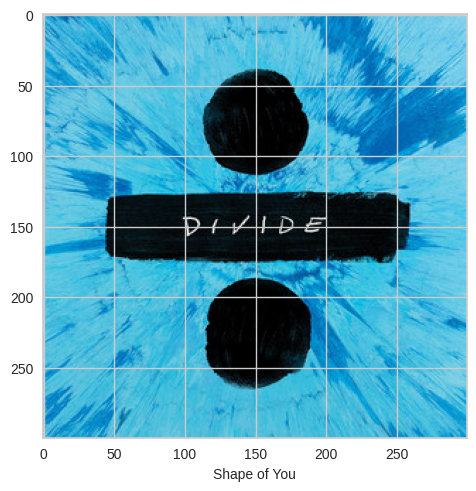

In [342]:
import matplotlib.pyplot as plt
from skimage import io

# Achando o id
nome_musica = 'Ed Sheeran - Shape of You'
id = dados[dados['artists_song'] == nome_musica]['id'].iloc[0]

# Requisição para a API
track = sp.track(id)
url = track['album']['images'][1]['url']
name = track['name']

# Mexendo com a imagem
image = io.imread(url)
plt.imshow(image)
plt.xlabel(name, fontsize = 10)
plt.show()



## Recomendador

### Buscando os dados da playlist

In [343]:
def recommend_id(playlist_id):
    url = []
    name = []
    artists = []
    duracao = []
    for i in playlist_id:
        track = sp.track(i)
        url.append(track["album"]["images"][1]["url"])
        name.append(track["name"])
        artists.append(track["artists"][0]["name"])
        duracao.append(round(track["duration_ms"]/60000, 2))

    return name, url, artists, duracao

In [344]:
name, url, artists, duracao = recommend_id(recomendada['id'])

In [345]:
artists

['Ed Sheeran',
 'Rauw Alejandro',
 'Clean Bandit',
 'Shawn Mendes',
 'Lil Uzi Vert',
 'Post Malone',
 'Anuel AA',
 'Anuel AA',
 'Anuel AA',
 'The Chainsmokers']

### Gerando as imagens da playlist

In [346]:
def visualize_songs(name, url):
  plt.figure(figsize=(15, 10))
  columns = 5

  for i, u in enumerate(url):
    ax = plt.subplot(len(url) // columns + 1, columns, i + 1)

    image = io.imread(u)

    plt.imshow(image)

    ax.get_yaxis().set_visible(False)

    plt.xticks(color = 'w', fontsize = 0.1)

    plt.yticks(color = 'w', fontsize = 0.1)

    plt.xlabel(name[i], fontsize=8)

    plt.tight_layout(h_pad=0.7, w_pad=0)

    plt.subplots_adjust(wspace=None, hspace=None)

    plt.tick_params(bottom = False)

    plt.grid(visible=None, linewidth=0)

  plt.show()




`plt.subplot`

O subplot do matplotlib é usado para que as imagens consigam ficar uma ao lado da outra, ou seja, para que as 10 capas de álbuns fiquem juntas lado a lado usando o subplot. Os parâmetros usados são para criar o número de colunas exibidas.

Para saber mais sobre os parâmetros que são aceitos, você pode acessar a documentação do matplotlib.pyplot.subplot.

`plt.imshow`

O imshow faz com que possamos observar nossos dados como imagem, no caso, a lista de urls em formato de imagem total. O parâmetro vem do imread da biblioteca Scikit Image.

Para saber quais outros parâmetros o imshow aceita, é necessário acessar a documentação do matplotlib.pyplot.imshow.

`ax.get_yaxis().set_visible(False)`

Quando usamos get_yaxis() estamos definindo que o eixo y é o foco da aplicação seguinte e que dentro dele podem ser passados parâmetros, que não é o caso nesse momento, porém para ver mais sobre a documentação matplotlib.axes.Axes.get_yaxis pode ser consultada.

A parte seguinte consiste em aplicarmos o set_visible() no eixo y, ele aceita True e False como parâmetro. O True é o padrão, então a possibilidade é utilizar o False para que o eixo y não apareça visualmente na resposta final.

Para saber mais, você pode acessar a documentação do matplotlib.axis.XAxis.set_visible.

`plt.xticks e plt.yticks`

O uso de plt.xticks e plt.yticks nos ajuda a obter e a definir os locais e rótulos dos ticks de cada eixo, seja ele no eixo x ou no y. Basicamente os ticks podem ser personalizados e, no caso atual da visualização, os parâmetros passados são a cor branca e o tamanho reduzido dos textos que existiam para que eles não apareçam visualmente na imagem final.

Para saber mais sobre os parâmetros que podem ser passados são observados na documentação em

- matplotlib.pyplot.xticks e matplotlib.pyplot.yticks.

`plt.xlabel`

Como os outros comandos de eixo, o plt.xlabel faz com que consigamos fazer modificações dentro do eixo x e, nesse caso, ele está recebendo um texto para ser colocado o nome de cada música. Também é possível definir qual será o tamanho da fonte que utilizada.

Para mais informações sobre os parâmetros que podem ser utilizados, você pode acessar a documentação do matplotlib.pyplot.xlabel.

`plt.tight_layout`

Esse módulo faz com que todos os outros módulos se ajustem perfeitamente na figura, ou seja, qualquer módulo feito antes ou depois dele será ajustado, seja ele rótulo de eixo, marcação ou títulos de eixo.

Para saber os parâmetros que podem ser passados, a documentação matplotlib.tight_layout pode ser consultada.

`plt.subplots_adjust`

Esse método ajusta os parâmetros de layout da imagem. No código passado em aula, o parâmetro wspace faz com que a largura de preenchimento das subparcelas seja ajustadas, já o hspace é para a altura.

Os parâmetros que podem ser passados nesse método são vistos na documentação em matplotlib.pyplot.subplots_adjust.

`plt.tick_params`

Esse módulo tem uma função semelhante ao que foi feito anteriormente com o ax.get_yaxis().set_visible(False), porém, como estamos utilizando um método para adicionar o título no eixo x, não podemos removê-lo totalmente como o eixo y, então, utilizando o método plt.tick_params, é possível remover apenas os marcadores.

Para saber mais sobre o método e quais os parâmetros podem ser passados, a documentação do matplotlib.pyplot.tick_params pode ser acessada.

`plt.grid`

Esse método é usado para retirar a grade da imagem que é gerada automaticamente nos plots do Matplotlib. O parâmetro utilizado é o visible=None. Para saber mais sobre o método, é necessário acessar a documentação em matplotlib.pyplot.grid.

Outras possibilidades de personalização podem ser feitas com o Matplotlib e a documentação pode auxiliar nesse processo.

/tmp/ipykernel_12435/2227336094.py:20: UserWarning:

The figure layout has changed to tight



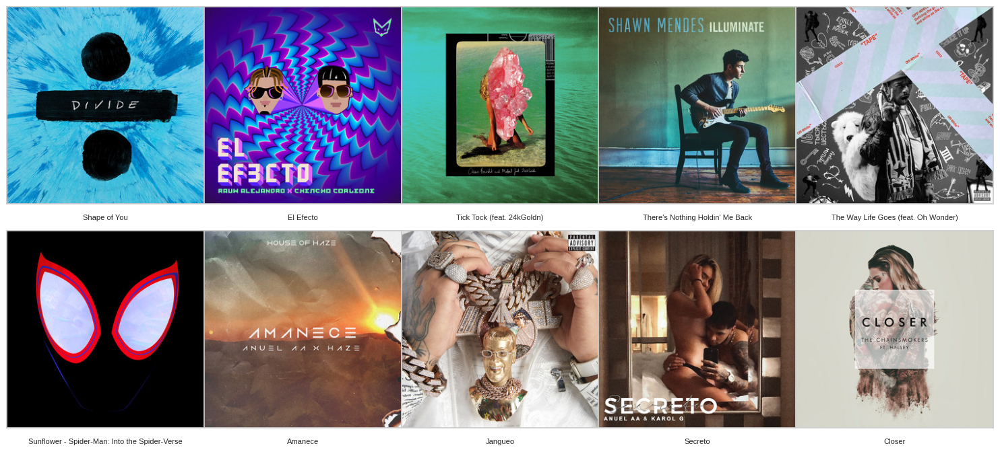

In [347]:
visualize_songs(name, url)

### Fazendo uma função final

In [348]:
def recomendador(nome_musica):

  cluster = list(projection_m[projection_m['song'] == nome_musica]['cluster_pca'])[0]
  musicas_recomendadas = projection_m[projection_m['cluster_pca'] == cluster][[0,1,2,3,4,5,6,7,8,9,10,11, 'song']]
  x_musica = list(projection_m[projection_m['song'] == nome_musica][0])[0]
  y_musica = list(projection_m[projection_m['song'] == nome_musica][1])[0]
  z_musica = list(projection_m[projection_m['song'] == nome_musica][2])[0]
  h_musica = list(projection_m[projection_m['song'] == nome_musica][3])[0]
  h1_musica = list(projection_m[projection_m['song'] == nome_musica][4])[0]
  h2_musica = list(projection_m[projection_m['song'] == nome_musica][5])[0]
  h3_musica = list(projection_m[projection_m['song'] == nome_musica][6])[0]
  h4_musica = list(projection_m[projection_m['song'] == nome_musica][7])[0]
  h5_musica = list(projection_m[projection_m['song'] == nome_musica][8])[0]
  h6_musica = list(projection_m[projection_m['song'] == nome_musica][9])[0]
  h7_musica = list(projection_m[projection_m['song'] == nome_musica][10])[0]
  h8_musica = list(projection_m[projection_m['song'] == nome_musica][11])[0]

  # distâncias euclidianas
  distancias = euclidean_distances(musicas_recomendadas[[0, 1,2,3,4,5,6,7,8,9,10,11]],
  [[x_musica, y_musica, z_musica, h_musica, h1_musica, h2_musica, h3_musica, h4_musica,
    h5_musica, h6_musica, h7_musica, h8_musica]])
  musicas_recomendadas['id'] = dados['id']
  musicas_recomendadas['distancias'] = distancias
  recomendada = musicas_recomendadas.sort_values('distancias').head(10)

  # # Calculando as distâncias
  # cluster = list(projection_m[projection_m['song'] == nome_musica]['cluster_pca'])[0]
  # musicas_recomendadas = projection_m[projection_m['cluster_pca'] == cluster][[0, 1, 'song']]
  # x_musica = list(projection_m[projection_m['song'] == nome_musica][0])[0]
  # y_musica = list(projection_m[projection_m['song'] == nome_musica][1])[0]

  # distancias = euclidean_distances(musicas_recomendadas[[0, 1]], [[x_musica, y_musica]])
  # musicas_recomendadas['id'] = dados['id']
  # musicas_recomendadas['distancias'] = distancias
  # recomendada = musicas_recomendadas.sort_values('distancias').head(10)

  playlist_id = recomendada['id']

  url = []
  name = []
  artists = []
  duracao = []
  for i in playlist_id:
      track = sp.track(i)
      url.append(track["album"]["images"][1]["url"])
      name.append(track["name"])
      artists.append(track["artists"][0]["name"])
      duracao.append(round(track["duration_ms"]/60000, 2))


  # Plotando as figuras
  plt.figure(figsize=(15, 10))
  columns = 5

  for i, u in enumerate(url):
    ax = plt.subplot(len(url) // columns + 1, columns, i + 1)
    image = io.imread(u)
    plt.imshow(image)
    ax.get_yaxis().set_visible(False)
    plt.xticks(color = 'w', fontsize = 0.1)
    plt.yticks(color = 'w', fontsize = 0.1)
    plt.xlabel(artists[i] + ' - ' + name[i], fontsize=12)
    plt.tight_layout(h_pad=0.7, w_pad=1)
    plt.subplots_adjust(wspace=None, hspace=None)
    plt.tick_params(bottom = False)
    plt.grid(visible=None, linewidth=0)

  plt.show()




/tmp/ipykernel_12435/1257612968.py:63: UserWarning:

The figure layout has changed to tight



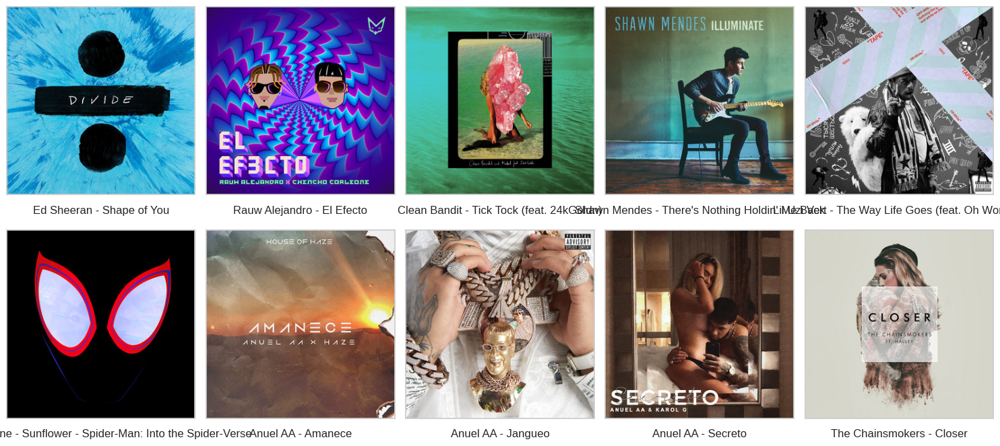

In [349]:
recomendador('Ed Sheeran - Shape of You')

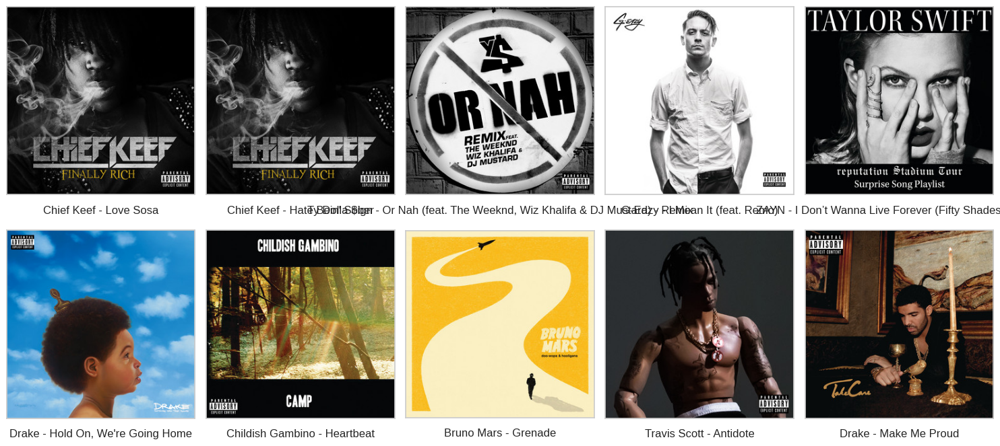

In [ ]:
recomendador('Chief Keef - Love Sosa')

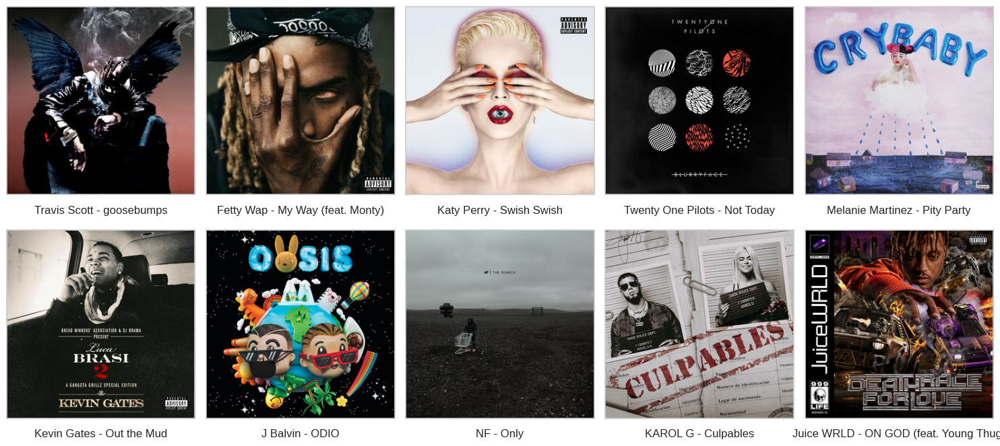

In [ ]:
recomendador('Travis Scott - goosebumps')

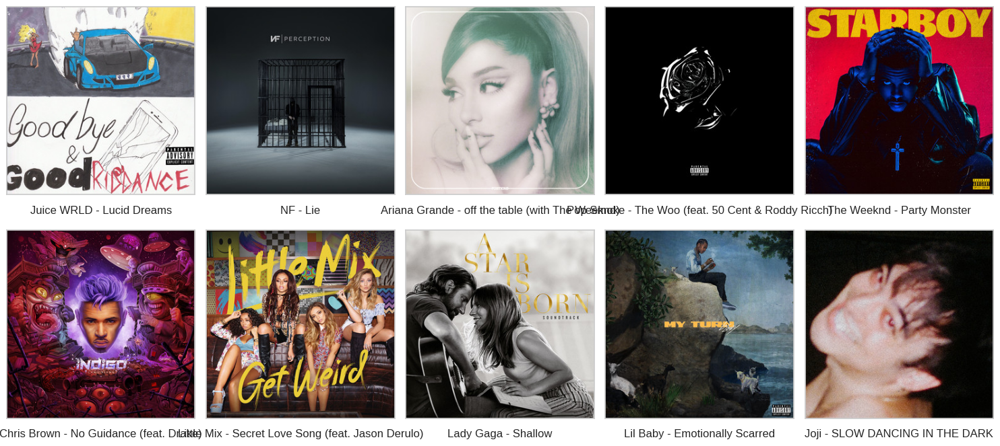

In [ ]:
recomendador('Juice WRLD - Lucid Dreams')

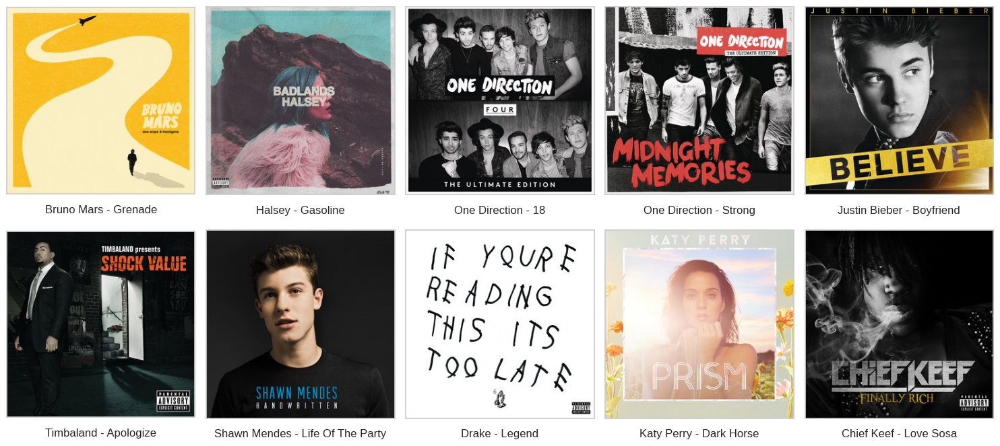

In [ ]:
recomendador('Bruno Mars - Grenade')

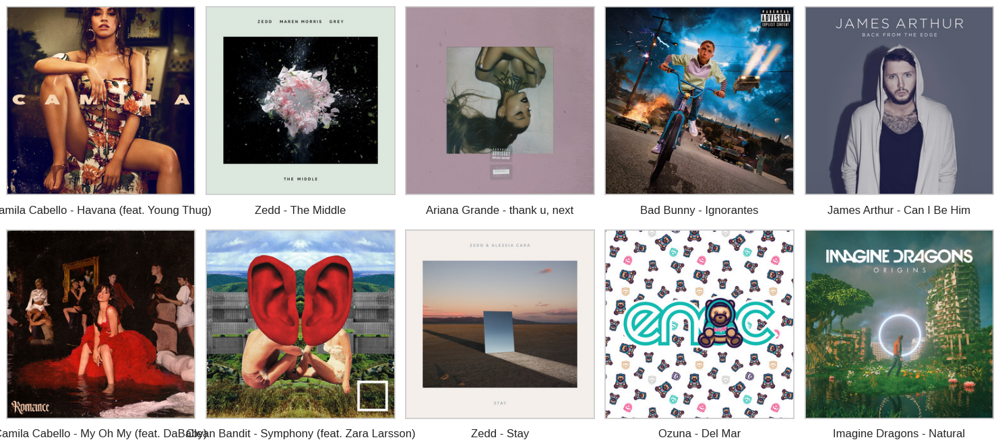

In [ ]:
recomendador('Camila Cabello - Havana (feat. Young Thug)')